# ParTIpy Analysis of on non-classical Monocytes from Lupus Data 

TODO
- Make functions work with andata object (add our dataframes to uns)
- Break functions up in those adding to andata and plotting
- add/fix t-ratio function
- Function mean archetype variance for different n_archetypes
- Functions to extract results more easily


In [1]:
import scanpy as sc
import seaborn as sns
from ParTIpy.paretoti_funcs import *
from ParTIpy.arch import AA
from ParTIpy.enrichment import *
import decoupler as dc
import matplotlib.pyplot as plt

## Load Data


In [2]:
adata = sc.read_h5ad("/gpfs/lsdf02/sd22b002/guest/ParTIpy/Data/Lupus.h5ad")

In [3]:
# Only ncM
adata_ncM = adata[adata.obs["cg_cov"] == 'ncM', :].copy()
adata_ncM

AnnData object with n_obs × n_vars = 38106 × 25275
    obs: 'batch_cov', 'ind_cov', 'Processing_Cohort', 'louvain', 'cg_cov', 'ct_cov', 'L3', 'sample_id', 'Age', 'Sex', 'pop_cov', 'Status', 'SLE_status', 'n_genes'
    var: 'ensembl', 'feature_types', 'n_cells'

## Quality Control

Following scanpy [tutorial](https://scanpy.readthedocs.io/en/stable/tutorials/basics/clustering.html)  
Mitochondrial, ribosomal and hemoglobin genes:

In [ ]:
adata_ncM.var["mt"] = adata_ncM.var_names.str.startswith("MT-")
adata_ncM.var["ribo"] = adata_ncM.var_names.str.startswith(("RPS", "RPL"))
adata_ncM.var["hb"] = adata_ncM.var_names.str.contains(("^HB[^(P)]"))

In [5]:
sc.pp.calculate_qc_metrics(
    adata_ncM, qc_vars=["mt", "ribo", "hb"], inplace=True, percent_top=[20], log1p=True
)

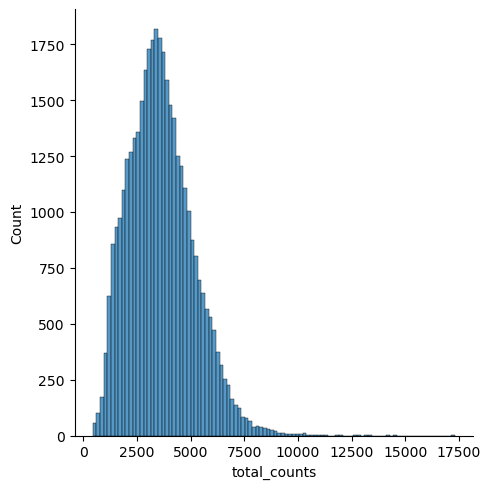

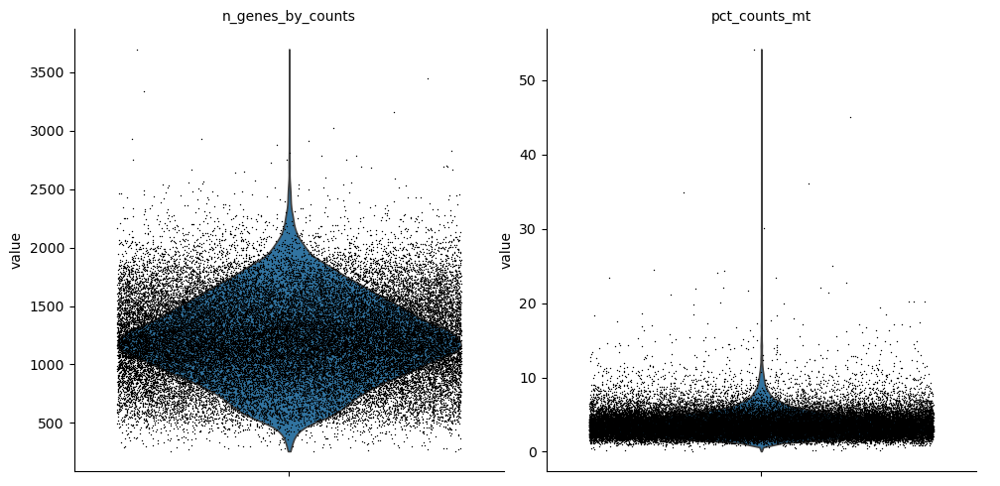

In [6]:
p1 = sns.displot(adata_ncM.obs["total_counts"], bins=100, kde=False)
sc.pl.violin(
    adata_ncM,
    ["n_genes_by_counts", "pct_counts_mt"],
    jitter=0.4,
    multi_panel=True,
)

In [ ]:
print(f"Total number of cells: {adata_ncM.n_obs} \nTotal number of genes: {adata_ncM.n_vars}")

Total number of cells: 38106 
Total number of genes: 25275


In [8]:
sc.pp.filter_cells(adata_ncM, min_genes=100)
sc.pp.filter_genes(adata_ncM, min_cells=3)

In [9]:
print(f"Number of cells after filtering of low quality cells: {adata_ncM.n_obs} \nNumber of genes after filtering of low quality genes: {adata_ncM.n_vars}")

Number of cells after filtering of low quality cells: 38106 
Number of genes after filtering of low quality genes: 18787


## Normalization

Normalize to median total counts and logharithmize the data

In [10]:
sc.pp.normalize_total(adata_ncM)
sc.pp.log1p(adata_ncM)

Find and plot highly variable genes

In [11]:
sc.pp.highly_variable_genes(adata_ncM)

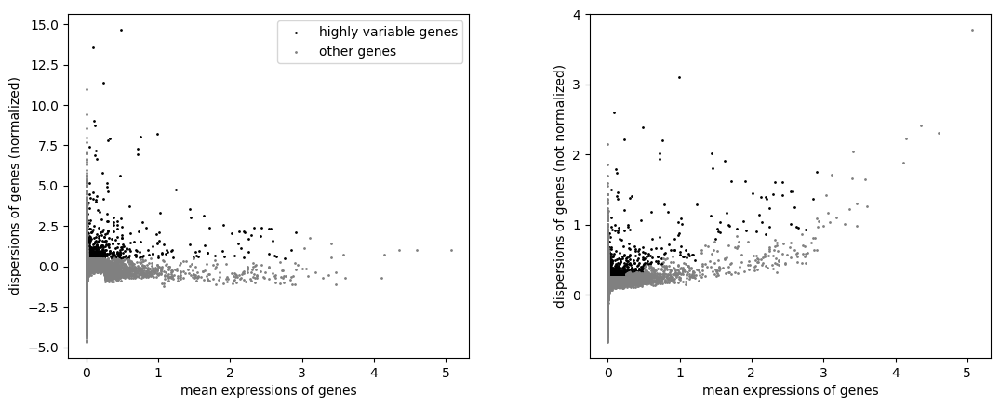

In [12]:
sc.pl.highly_variable_genes(adata_ncM)

## Dimension Reduction

Calculate and plot PCA

In [13]:
sc.pp.pca(adata_ncM, mask_var="highly_variable")

apply z-scaling, since we are interested in the differences between the cells/archetypes

In [14]:
adata_ncM.layers["z_scaled"]= sc.pp.scale(adata_ncM.X, max_value=10)

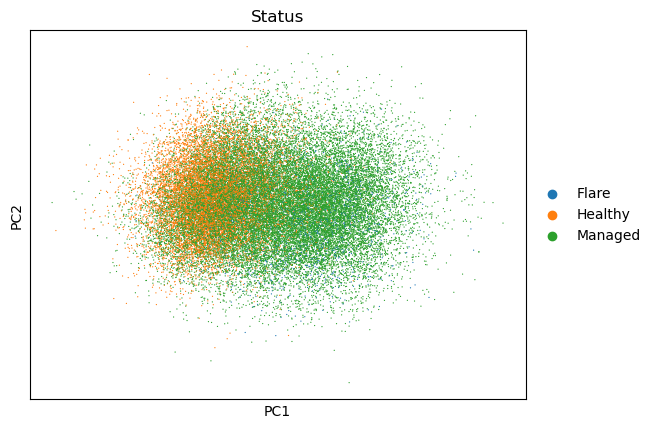

In [15]:
sc.pl.pca_scatter(adata_ncM, color="Status", layer="z_scaled")

# For coloring after batch use:
# color="Processing_Cohort"

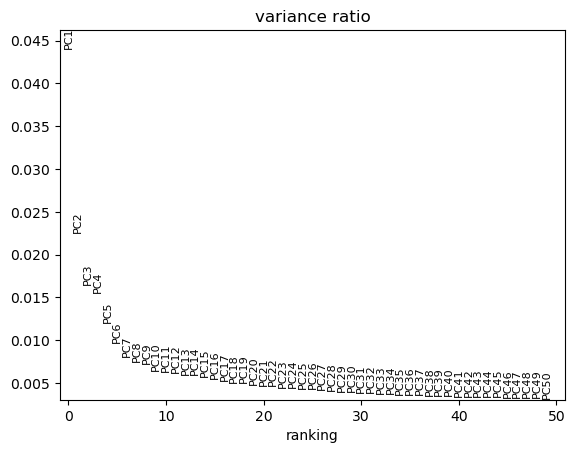

In [ ]:
sc.pl.pca_variance_ratio(adata_ncM, n_pcs=50)

Now choose the number of PCs you want to use for AA. Here we coose 7

In [ ]:
n_pcs = 7

## Number of Archetypes

First we look at how much variance is explained for different numbers of archetypes

In [18]:
# Extract data
X = adata_ncM.obsm["X_pca"][:, :n_pcs]
X.shape

(38106, 7)

In [19]:
p1, p2, p3, plot_df = var_explained_aa(X)

Plot 1 shows the explained variance by the models with different numbers of archetypes. The grey line connects the first and last EV, helping to find the "elbow" of the black curve.

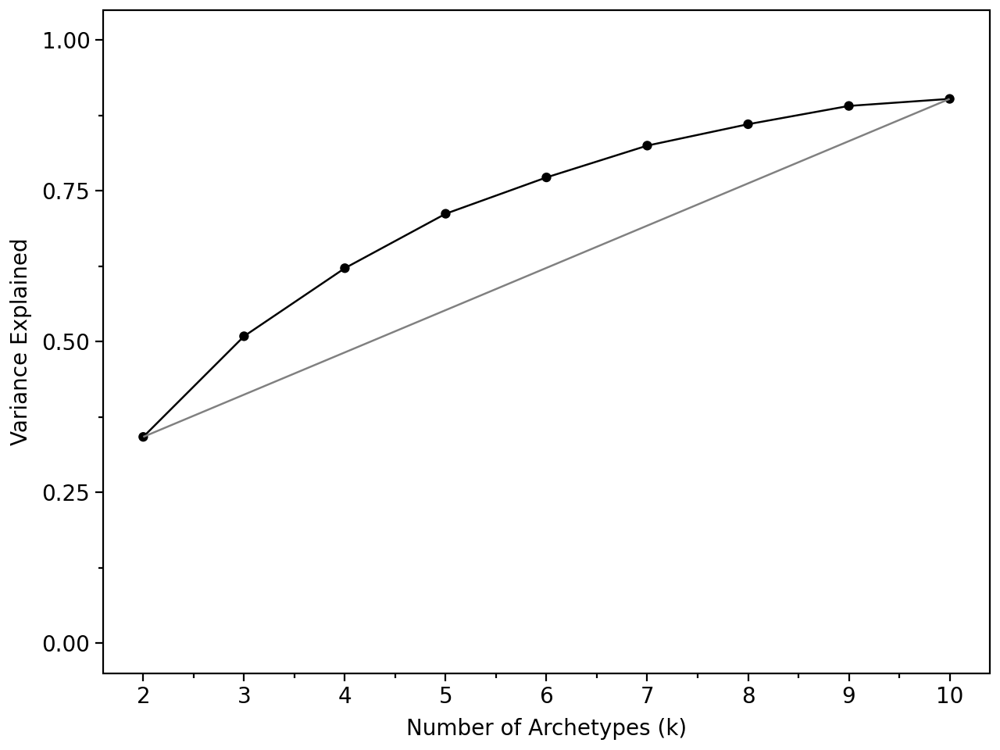

In [20]:
p1

Since the axis scaling is not equal, the projection from the furthest point of the black line to the grey line would not look orthagonal. We can visualize the distances with plot 2, revealing 5 Archetypes as the "elbow". 

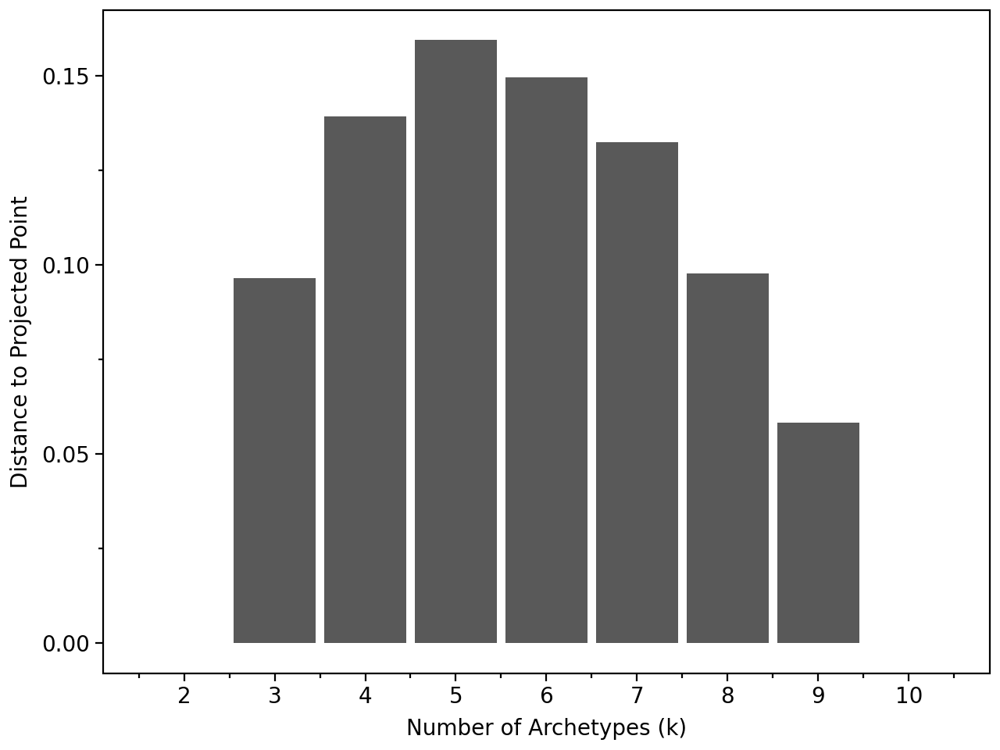

In [21]:
p2

Additionally we visualize the explained variance added by each archetype.

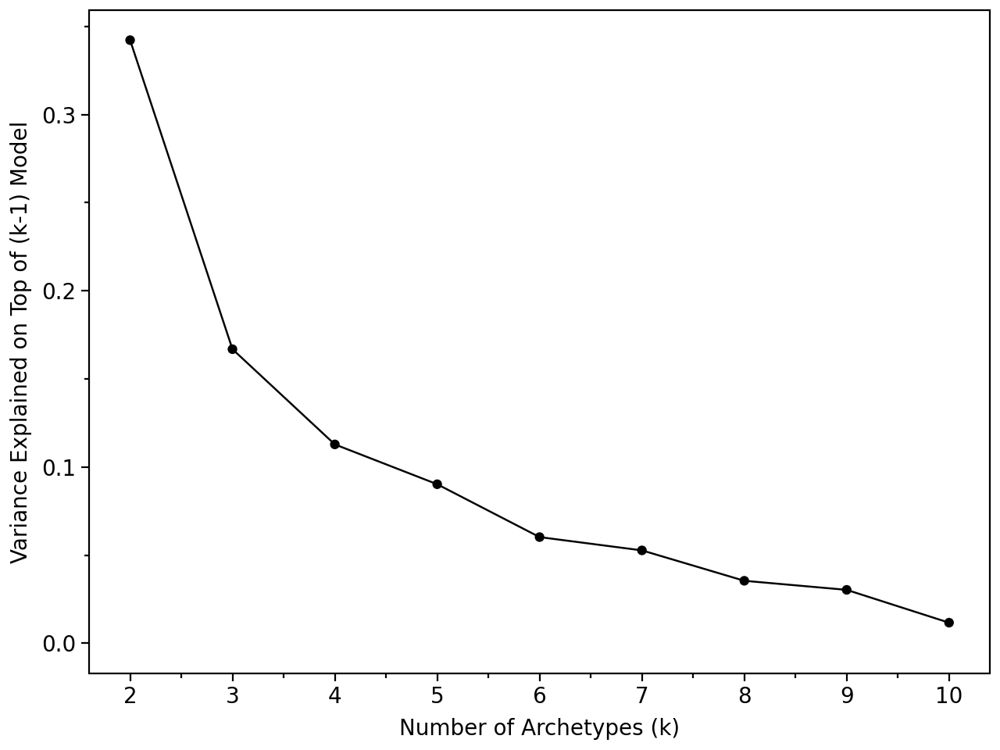

In [22]:
p3

In [23]:
plot_df

,k,varexpl,varexpl_ontop,dist_to_projected
0,2,0.342221,0.342221,0.000000
1,3,0.509094,0.166873,0.096583
2,4,0.621943,0.112849,0.139274
3,5,0.712190,0.090247,0.159418
4,6,0.772446,0.060255,0.149644
5,7,0.825167,0.052721,0.132354
6,8,0.860633,0.035466,0.097852
7,9,0.890954,0.030321,0.058217
8,10,0.902648,0.011694,0.000000


Choose 4 as the number of archetypes. To confirm this choice, we bootstrap the archetypes.

In [ ]:
n_archetypes = 4

Test how stable the archetypes are with bootsrapping

In [25]:
bootstrap_df, fig_bootstrap_AA = bootstrap_AA(X, n_bootstrap=5, n_archetypes=n_archetypes, opacity=0.5)
fig_bootstrap_AA.show()

In [ ]:
bootstrap_df

,pc_0,pc_1,pc_2,pc_3,pc_4,pc_5,pc_6,archetype,iter,reference,variance_per_archetype,mean_variance
0,1.777950,4.420336,-2.378698,-1.352312,0.564991,0.039494,-0.300667,0,1,False,0.839104,0.670198
1,6.188856,-1.973357,0.770540,0.522010,-0.308187,-0.060260,0.117843,1,1,False,0.093191,0.670198
2,-5.396343,2.306962,4.080320,3.555760,-0.861210,-0.760243,0.236313,2,1,False,1.583499,0.670198
3,-3.307060,-3.433427,-1.226042,-1.408888,0.287431,0.345949,-0.045978,3,1,False,0.164997,0.670198
0,2.705293,3.902787,1.399287,-2.874889,0.839279,0.020072,-0.064446,0,2,False,0.839104,0.670198
1,6.091582,-3.046217,-0.717160,1.391914,-0.241936,-0.078934,0.167796,1,2,False,0.093191,0.670198
2,-3.373141,2.633553,-1.292300,3.775837,-1.125619,0.039035,0.090465,2,2,False,1.583499,0.670198
3,-3.831116,-2.622338,0.364536,-1.489749,0.301705,-0.110488,-0.151816,3,2,False,0.164997,0.670198
0,1.566308,4.857223,-2.476038,-1.568320,0.704721,-0.194168,-0.394649,0,3,False,0.839104,0.670198
1,6.228191,-2.556815,0.673258,0.506486,-0.510648,0.017513,0.045754,1,3,False,0.093191,0.670198


This can be run to see how different numbers of archetypes influence the mean archetype variance

In [ ]:
# res = []
# for i in range(2,6):

#     bootstrap_df = bootstrap_AA(X, n_bootstrap=i, n_archetypes=n_archetypes, plot=False)

#     for value in bootstrap_df['mean_variance']:
#         res.append({'iteration': i, 'mean_variance': value})

# results_df = pd.DataFrame(res)

In [ ]:
# results_df_2 = results_df.drop_duplicates(keep='first')


In [ ]:
# p = (
#         pn.ggplot(results_df_2, pn.aes(x="iteration", y="mean_variance"))
#         + pn.geom_point(color="blue")
#         + pn.geom_line(color="blue")
#         + pn.labs(x="Number of Archetypes", y="Mean Variance in Archetype Position")
#     )
# p

## Archetype calculation and visualization

This looks good. Now let us compute the four archetypes 

In [30]:
AA_object = AA(n_archetypes=n_archetypes, 
                   optim="projected_gradients", 
                   init="random",
                   max_iter=100).fit(X).return_all()

In [31]:
AA_object

(array([[0.46687697, 0.36488248, 0.06329794, 0.10494261],
        [0.16980577, 0.35992377, 0.22380778, 0.24646268],
        [0.33763648, 0.        , 0.19846594, 0.46389758],
        ...,
        [0.50460749, 0.12392534, 0.3110095 , 0.06045767],
        [0.1443823 , 0.64038484, 0.12575126, 0.0894816 ],
        [0.26645045, 0.6571982 , 0.07635135, 0.        ]]),
 array([[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]]),
 array([[ 6.21389426, -2.30873746,  0.81716809,  0.70026984, -0.38013789,
         -0.03916053,  0.21303738],
        [-3.38664273, -3.38966426, -1.25894174, -1.37791505,  0.31766122,
          0.28748746,  0.02443594],
        [ 1.93830886,  4.68720383, -2.17847195, -1.78955883,  0.55479444,
          0.01312644, -0.41682501],
        [-5.45124065,  2.13231112,  4.06933976,  3.9156781 , -0.84440218,
         -0.68131942,  0.16080054]]),
 175825.75085732632,
 0.6225168801315

Save the archetypes in Z

In [ ]:
Z = AA_object[2]

Plot in 2d and 3d

In [ ]:
# col=adata_ncM[:, "IFI27"].X.toarray().flatten()
col=adata_ncM.obs["Status"]

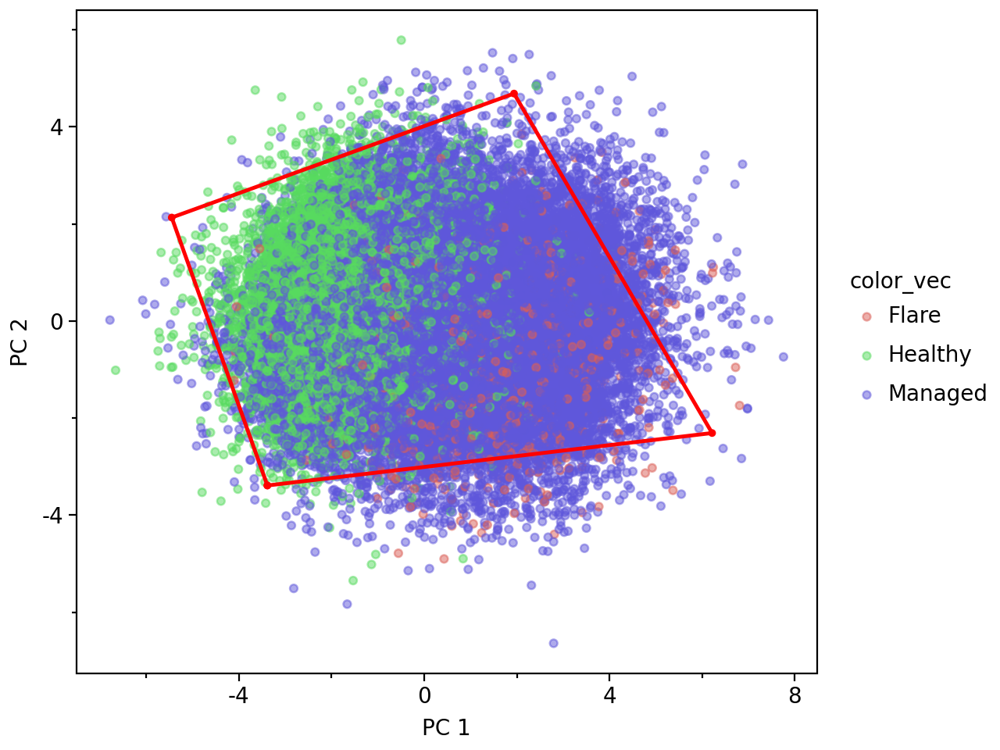

In [34]:
plot_2D(X,Z, alpha=0.5, color_vec=col)

In [55]:
# fig_3D_simplex = plot_3D(X[:2000],Z, color_vec=col[:2000], opacity=0.5)
# fig_3D_simplex = plot_3D(X,Z, color_vec=col, opacity=0.5)

fig_3D_simplex = plot_3D(X[adata_ncM.obs["Status"] == "Healthy"],Z, opacity=0.5)
fig_3D_simplex.show()

t-ratio

Decoupler

In [36]:
msigdb_raw = dc.get_resource('MSigDB')
msigdb = msigdb_raw[msigdb_raw['collection']=='go_biological_process']
msigdb = msigdb[~msigdb.duplicated(['geneset', 'genesymbol'])]

## Identify representatives

In [37]:
adata_ncM.obsm["PCA"] = adata_ncM.obsm["X_pca"][:, :n_pcs]

Calculate weights based on distance from archetype

In [38]:
euc_dist = euclidean_distance(adata_ncM.obsm["PCA"], Z.T)
weights, l = rbf_kernel(euc_dist, mode = 'automatic', data = adata_ncM.obsm["PCA"], archetypes = Z.T)

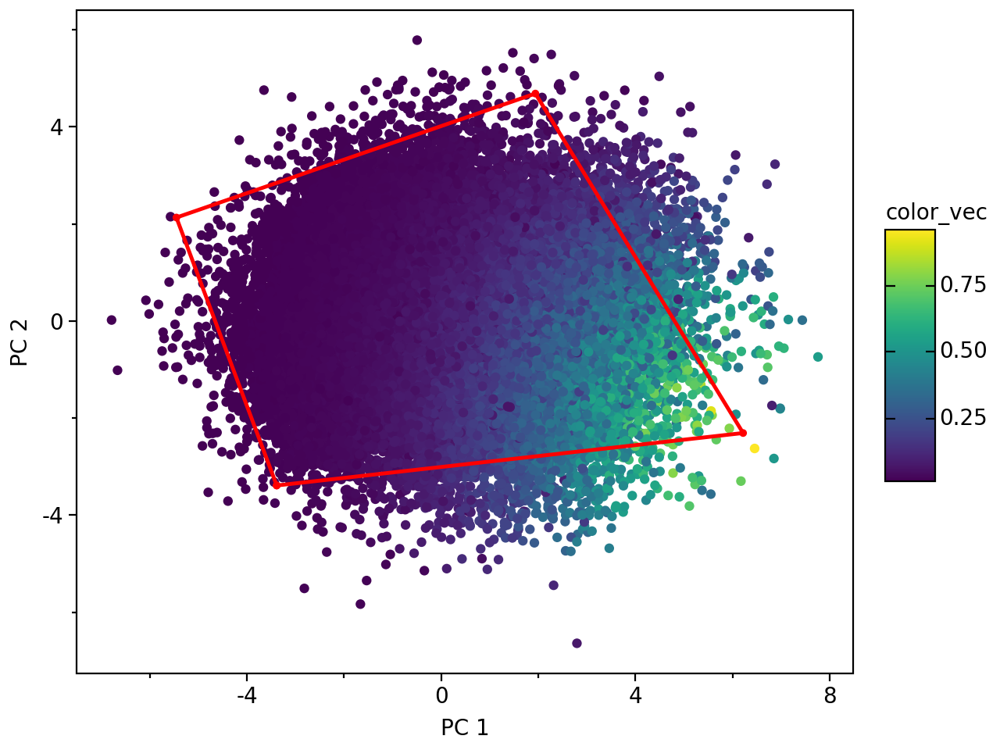

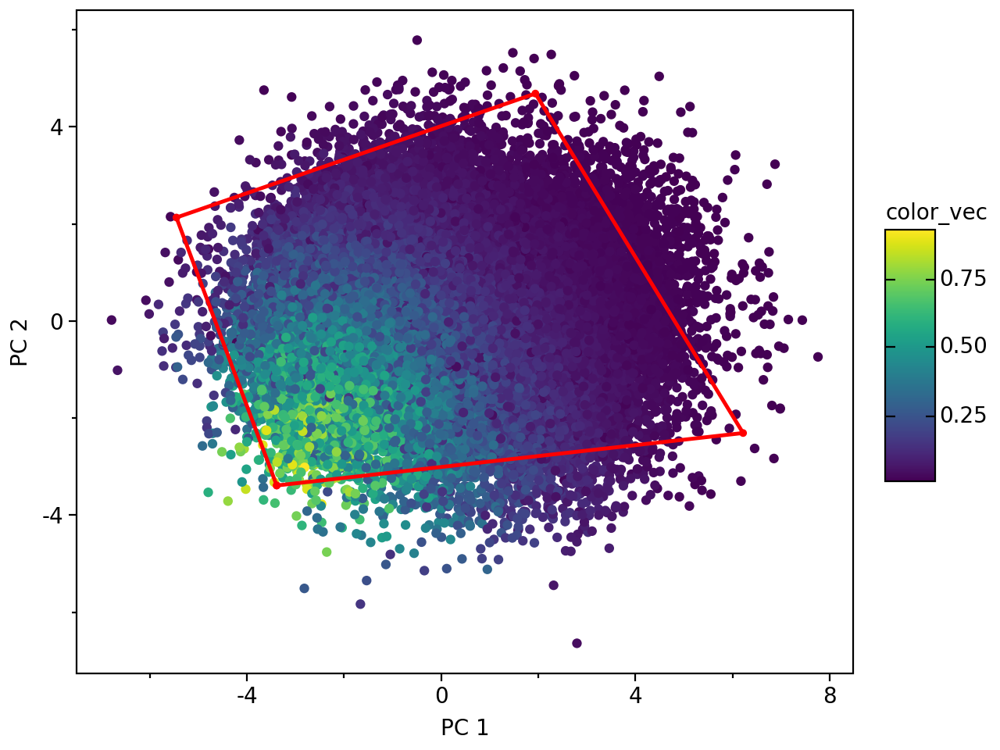

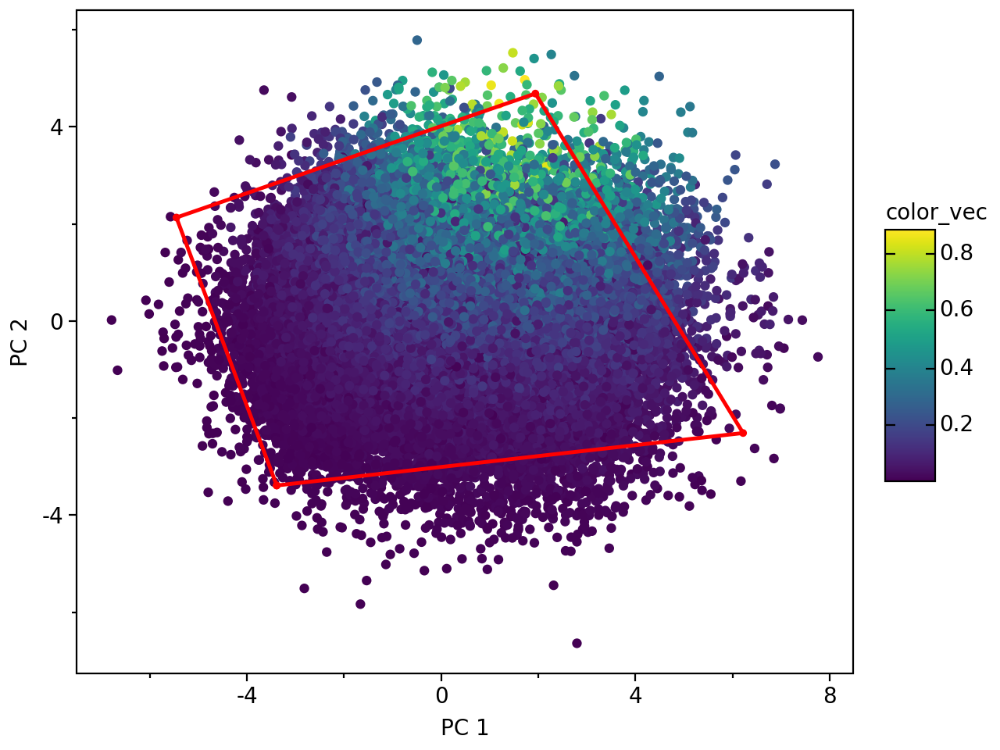

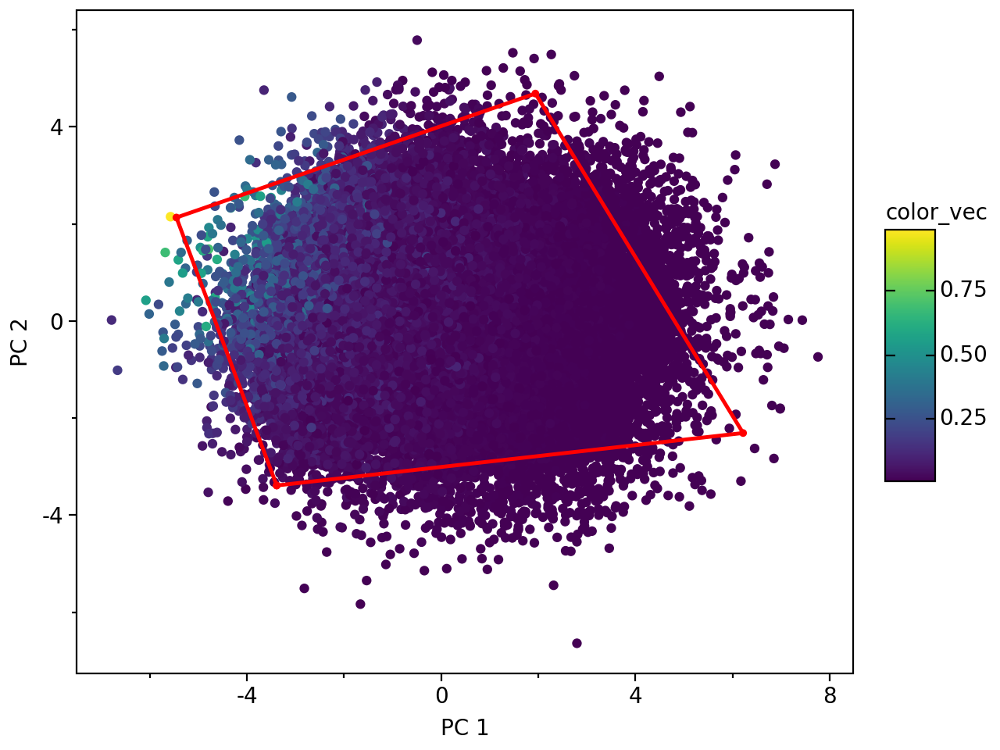

In [ ]:
for i in range(0,4):
    plt = plot_2D(X, Z, color_vec=weights[i])
    plt.show()
# For 3D plot just replace the function name

Calculate a pseudopulk with the z scaled gene expression

In [40]:
pseudobulk = weighted_expr(weights, adata_ncM.layers["z_scaled"])

In [41]:
pseudobulk_df = pd.DataFrame(pseudobulk)

gene_names = adata_ncM.var_names
pseudobulk_df.columns = gene_names

print(pseudobulk_df.head())

   RP11-34P13.7  AL627309.1  AP006222.2  RP4-669L17.10  RP11-206L10.3  \
0     -0.021163   -0.013951    0.007054      -0.022265      -0.018431   
1     -0.020372   -0.010423    0.002435      -0.021206      -0.016012   
2     -0.019150   -0.009650    0.003504      -0.021370      -0.007765   
3     -0.021506    0.010647   -0.015503      -0.015105       0.055023   

   RP11-206L10.5  RP11-206L10.2  RP11-206L10.9    FAM87B  LINC00115  ...  \
0      -0.008878      -0.025742      -0.023893 -0.015173  -0.011302  ...   
1      -0.009859      -0.012453      -0.022726 -0.016291  -0.013934  ...   
2      -0.009304      -0.003120      -0.014652 -0.015042  -0.009098  ...   
3      -0.010145       0.035476      -0.004053 -0.014139  -0.010706  ...   

     MT-ND6    MT-CYB  AC145212.1  AC011043.1  AL592183.1  AC011841.1  \
0 -0.067295 -0.542595   -0.015089   -0.011537   -0.073597   -0.014522   
1 -0.000460  0.196424   -0.017212   -0.013239    0.032041   -0.013318   
2 -0.020005 -0.042310   -0.001851 

## Functional Enrichment

In [42]:
acts_ulm_est, acts_ulm_est_p = dc.run_ulm(mat = pseudobulk_df,
                                net = msigdb,
                                weight = None,
                                source='geneset',
                                target='genesymbol')

acts_ulm_est

,GOBP_EMBRYO_DEVELOPMENT,GOBP_POSITIVE_REGULATION_OF_RNA_METABOLIC_PROCESS,GOBP_REGULATION_OF_EPITHELIAL_CELL_DIFFERENTIATION,GOBP_EMBRYO_DEVELOPMENT_ENDING_IN_BIRTH_OR_EGG_HATCHING,GOBP_IN_UTERO_EMBRYONIC_DEVELOPMENT,GOBP_MULTI_MULTICELLULAR_ORGANISM_PROCESS,GOBP_NEGATIVE_REGULATION_OF_BIOSYNTHETIC_PROCESS,GOBP_EPITHELIUM_DEVELOPMENT,GOBP_POSITIVE_REGULATION_OF_TRANSCRIPTION_BY_RNA_POLYMERASE_II,GOBP_EPIDERMIS_DEVELOPMENT,...,GOBP_RIBOSOME_ASSOCIATED_UBIQUITIN_DEPENDENT_PROTEIN_CATABOLIC_PROCESS,GOBP_OUTER_DYNEIN_ARM_ASSEMBLY,GOBP_NEGATIVE_REGULATION_OF_PROTEIN_LOCALIZATION_TO_MICROTUBULE,GOBP_MITOCHONDRIAL_RIBOSOME_ASSEMBLY,GOBP_DETERMINATION_OF_DIGESTIVE_TRACT_LEFT_RIGHT_ASYMMETRY,GOBP_EPITHELIAL_CILIUM_MOVEMENT_INVOLVED_IN_DETERMINATION_OF_LEFT_RIGHT_ASYMMETRY,GOBP_TRNA_THIO_MODIFICATION,GOBP_REGULATION_OF_LYSOSOME_ORGANIZATION,GOBP_C_TERMINAL_PROTEIN_LIPIDATION,GOBP_ADENYLATE_CYCLASE_INHIBITING_G_PROTEIN_COUPLED_GLUTAMATE_RECEPTOR_SIGNALING_PATHWAY
0,-2.581937,1.191153,-1.368918,-1.608426,-0.645137,0.210770,0.673811,-1.025022,0.123126,-1.320804,...,0.456090,-0.386300,-0.574144,0.372681,-0.452890,-0.290957,0.125535,4.881804,0.804455,-0.293907
1,1.155314,-0.969234,-2.947782,0.579917,0.311682,-1.874413,-1.344320,-1.555729,-2.941383,-1.166591,...,0.599427,-0.488955,-0.394729,0.817460,-0.745201,-0.546313,0.736256,-4.415355,-0.162222,0.367069
2,1.434863,9.119134,1.235620,1.417444,2.595980,3.040843,7.021953,2.614078,6.670335,2.504956,...,0.738909,-0.580676,-0.149659,0.840890,-0.490493,-0.315477,0.287739,3.020632,0.808486,-0.667879
3,6.347663,12.511641,2.886574,5.503739,4.593159,0.016858,10.052777,4.268152,10.684836,2.478878,...,1.170653,-0.113973,0.923240,-0.070379,0.157272,0.486743,-0.586273,-2.706593,0.351536,-0.073251


In [43]:
archetype = 1
filtered_columns = acts_ulm_est_p.iloc[archetype] < 0.05
acts_ulm_est.iloc[archetype, list(filtered_columns)].nlargest(10)

GOBP_CYTOPLASMIC_TRANSLATION                           9.673152
GOBP_RNA_PROCESSING                                    8.851402
GOBP_RIBONUCLEOPROTEIN_COMPLEX_BIOGENESIS              7.910145
GOBP_AMIDE_BIOSYNTHETIC_PROCESS                        7.639770
GOBP_PEPTIDE_BIOSYNTHETIC_PROCESS                      7.466660
GOBP_ORGANONITROGEN_COMPOUND_BIOSYNTHETIC_PROCESS      7.436573
GOBP_RIBONUCLEOPROTEIN_COMPLEX_SUBUNIT_ORGANIZATION    7.367344
GOBP_CELLULAR_MACROMOLECULE_BIOSYNTHETIC_PROCESS       7.215191
GOBP_MRNA_PROCESSING                                   6.796205
GOBP_AMIDE_METABOLIC_PROCESS                           6.607676
Name: 1, dtype: float32

Get top 20 enriched processes per archetype

In [44]:
for archetype in [0, 1, 2, 3]:
    filtered_columns = acts_ulm_est_p.iloc[archetype] < 0.05
    top_values = acts_ulm_est.iloc[archetype, list(filtered_columns)].nlargest(20)
    
    print(f"\n{'='*10} Archetype {archetype} {'='*10}")  # Clear header
    print(top_values.to_string())  # Ensures proper formatting
    print("-" * 50)  # Separator



========== Archetype 0 ==========
GOBP_NEGATIVE_REGULATION_OF_VIRAL_GENOME_REPLICATION                              29.261604
GOBP_NEGATIVE_REGULATION_OF_VIRAL_PROCESS                                         28.129650
GOBP_DEFENSE_RESPONSE_TO_SYMBIONT                                                 26.728619
GOBP_DEFENSE_RESPONSE_TO_OTHER_ORGANISM                                           25.388409
GOBP_INNATE_IMMUNE_RESPONSE                                                       25.088573
GOBP_RESPONSE_TO_VIRUS                                                            24.479570
GOBP_BIOLOGICAL_PROCESS_INVOLVED_IN_INTERSPECIES_INTERACTION_BETWEEN_ORGANISMS    24.159769
GOBP_DEFENSE_RESPONSE                                                             23.438442
GOBP_REGULATION_OF_VIRAL_PROCESS                                                  23.168356
GOBP_REGULATION_OF_VIRAL_GENOME_REPLICATION                                       22.915892
GOBP_IMMUNE_RESPONSE                         

Processes that are in the top enriched of one archetype and have a score below 5 for all other archetypes. Also added coverage ot the process

In [66]:
archetype = "3"

filtered_columns = acts_ulm_est_p.loc[archetype] < 0.05

highest_processes = acts_ulm_est.loc[archetype, filtered_columns.index].nlargest(50).index

subset = acts_ulm_est.loc[:, highest_processes]

filtered_processes = highest_processes[(subset.drop(index=archetype) < 5).all(axis=0)]
# coverage
msigdb['in_adata'] = msigdb["genesymbol"].isin(adata_ncM.var.index.to_list())
msigdb["geneset"] = msigdb["geneset"].astype(str)

coverage_result = msigdb.groupby("geneset").agg(
    coverage=pd.NamedAgg(column="in_adata", aggfunc="mean")
).reset_index()

coverage_dict = dict(zip(coverage_result["geneset"], coverage_result["coverage"]))

# Add coverage as a row in the resulting DataFrame
result_with_coverage = acts_ulm_est.loc[:, filtered_processes].copy()
result_with_coverage.loc["coverage"] = [coverage_dict.get(process, 0) for process in filtered_processes]

result_with_coverage

,GOBP_CHROMATIN_ORGANIZATION,GOBP_NEGATIVE_REGULATION_OF_RNA_BIOSYNTHETIC_PROCESS,GOBP_NEGATIVE_REGULATION_OF_TRANSCRIPTION_BY_RNA_POLYMERASE_II,GOBP_HISTONE_MODIFICATION,GOBP_CHROMATIN_REMODELING,GOBP_CIRCADIAN_RHYTHM,GOBP_PEPTIDYL_SERINE_MODIFICATION,GOBP_RESPONSE_TO_GROWTH_FACTOR,GOBP_ENZYME_LINKED_RECEPTOR_PROTEIN_SIGNALING_PATHWAY,GOBP_RHYTHMIC_PROCESS,GOBP_INSULIN_RECEPTOR_SIGNALING_PATHWAY,GOBP_REGULATION_OF_HYDROGEN_PEROXIDE_BIOSYNTHETIC_PROCESS,GOBP_PROTON_MOTIVE_FORCE_DRIVEN_ATP_SYNTHESIS,GOBP_CELLULAR_RESPONSE_TO_INSULIN_STIMULUS,GOBP_EMBRYO_DEVELOPMENT,GOBP_EPIGENETIC_REGULATION_OF_GENE_EXPRESSION,GOBP_CELL_CELL_SIGNALING_BY_WNT
0,-0.841881,0.328411,-0.735714,0.596673,-1.170658,-1.833509,-0.763676,-2.219833,-0.929845,-1.684666,-1.223652,-6.317642,-2.308223,-0.125635,-2.581937,0.539410,-1.965271
1,4.599058,-1.531966,-1.484301,2.958104,4.071492,-1.761649,-0.004773,-0.886431,-2.965896,-1.677831,-1.362261,2.859908,2.549736,-2.077615,1.155314,1.143798,1.033529
2,2.559694,4.805550,3.286928,3.114187,1.813196,2.608437,2.145647,2.230441,2.066108,1.848416,3.149246,-1.879122,4.611557,4.895181,1.434863,1.010033,-0.331508
3,10.434361,9.385511,9.084257,8.617611,8.254764,6.989336,6.962075,6.950612,6.929754,6.823772,6.697763,6.637171,6.492605,6.425180,6.347663,6.327927,6.098345
coverage,0.815235,0.767460,0.765935,0.854737,0.807065,0.743961,0.795031,0.707801,0.719462,0.733553,0.808000,0.750000,0.710526,0.807692,0.710222,0.840000,0.729490


## Enrichment Metadata

Discuss how we should normalize here.

First one-hot-encoding & normalizing per metadata category (since e.g. healthy has so many more cells than flare)

In [ ]:
df_encoded = pd.get_dummies(pd.DataFrame(adata_ncM.obs["Status"]), columns=["Status"]).astype(float)
df_encoded = df_encoded / df_encoded.values.sum(axis=0, keepdims=True)

,Status_Flare,Status_Healthy,Status_Managed
AATCCAGCAAATCCGT-1-1-0-0-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,0.000756,0.000000,0.000000
AAGCCGCAGTGAAGTT-1-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-1-0-0-0-0-0-0,0.000000,0.000094,0.000000
ACACCCTTCTCACATT-1-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,0.000000,0.000000,0.000038
CTACATTAGTGTCCAT-1-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,0.000000,0.000000,0.000038
CGGAGCTTCATCACCC-1-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-1-0-0-0-0-0-0-0-0-0-0-0-0-0,0.000000,0.000000,0.000038
...,...,...,...
CATATTCTCGCGTTTC-1-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,0.000000,0.000000,0.000038
CAGGTGCAGGGAAACA-1-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,0.000000,0.000000,0.000038
CACACCTAGGCGATAC-1-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,0.000000,0.000000,0.000038
ATAAGAGAGATCGATA-1-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-1-0-0-0-0-0-0-0,0.000000,0.000094,0.000000


In [47]:
assert np.all(np.isclose(df_encoded.sum(axis=0).to_numpy(), 1.0))

Multiply with weights

In [69]:
weighted_status = weighted_expr(weights, df_encoded)

Normalize per archetype

In [70]:
weighted_status = weighted_status / np.sum(weighted_status, axis=1, keepdims=True)

In [72]:
weighted_status_df = pd.DataFrame(weighted_status, columns=['Flare', 'Healthy', 'Managed'])
weighted_status_df

,Flare,Healthy,Managed
0,0.546492,0.081262,0.372246
1,0.249188,0.463868,0.286944
2,0.306199,0.323331,0.370471
3,0.143752,0.590276,0.265972


Visualization

In [52]:
Z

array([[ 6.21389426, -2.30873746,  0.81716809,  0.70026984, -0.38013789,
        -0.03916053,  0.21303738],
       [-3.38664273, -3.38966426, -1.25894174, -1.37791505,  0.31766122,
         0.28748746,  0.02443594],
       [ 1.93830886,  4.68720383, -2.17847195, -1.78955883,  0.55479444,
         0.01312644, -0.41682501],
       [-5.45124065,  2.13231112,  4.06933976,  3.9156781 , -0.84440218,
        -0.68131942,  0.16080054]])

In [53]:
plot_3D(X[adata_ncM.obs["Status"] == "Flare"], Z)